In [1]:
import numpy as np
import pandas as pd
import os
import random
import matplotlib.pyplot as plt
import librosa
import librosa.display
import IPython, IPython.display 


In [2]:

def pghi_stft(x):
    use_truncated_window = True
    if use_truncated_window:
        stft_system = GaussTruncTF(hop_size=hop_size, stft_channels=stft_channels)
    else:
        stft_system = GaussTF(hop_size=hop_size, stft_channels=stft_channels)
    Y = stft_system.spectrogram(x)
    log_Y= log_spectrogram(Y)
    return np.expand_dims(log_Y,axis=0)
def zeropad(signal, audio_length):
    if len(signal) < audio_length:
        return np.append(
            signal,
            np.zeros(audio_length - len(signal))
        )
    else:
        signal = signal[0:audio_length]
        return signal
def pghi_istft(x):
    use_truncated_window = True
    if use_truncated_window:
        stft_system = GaussTruncTF(hop_size=hop_size, stft_channels=stft_channels)
    else:
        stft_system = GaussTF(hop_size=hop_size, stft_channels=stft_channels)
    x = np.squeeze(x,axis=0)
    new_Y = inv_log_spectrogram(x)
    new_y = stft_system.invert_spectrogram(new_Y)
    return new_y
def renormalize(n, range1, range2):
    delta1 = range1[1] - range1[0]
    delta2 = range2[1] - range2[0]
    return (delta2 * (n - range1[0]) / delta1) + range2[0]
def read_and_plot(f, title=None):
    y, sr = librosa.load(f, sr=sample_rate)
    plot(y, title)
def plot(y, title=None):
    IPython.display.display(IPython.display.Audio(y, rate=sample_rate))
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
    y_pghi = y
    y_pghi = preprocess_signal(y_pghi)
    y_pghi = zeropad(y_pghi, n_frames * hop_size )
    y_pghi = pghi_stft(y_pghi)
    a=librosa.display.specshow(y_pghi[0],x_axis='time', y_axis='linear', ax=ax[0], sr=sample_rate, hop_length=hop_size)
    ax[0].set_title(title)
    ax[1].plot(y)
def plot_multi(y1, y2, title1=None, title2=None):
    sample_rate = 16000
    IPython.display.display(IPython.display.Audio(y1, rate=sample_rate))
    IPython.display.display(IPython.display.Audio(y2, rate=sample_rate))
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y1, n_fft=512, hop_length=128)), ref=np.max)
    img = librosa.display.specshow(D, y_axis='linear', x_axis='time', ax=ax[0],sr=sr, hop_length=128)
#     y_pghi = y1
#     y_pghi = preprocess_signal(y_pghi)
#     y_pghi = zeropad(y_pghi, n_frames * hop_size )
#     y_pghi = pghi_stft(y_pghi)
#     a=librosa.display.specshow(y_pghi[0],x_axis='time', y_axis='linear', ax=ax[0], sr=sample_rate, hop_length=hop_size)
    ax[0].set_title(title1)
#     y_pghi = y2
#     y_pghi = preprocess_signal(y_pghi)
#     y_pghi = zeropad(y_pghi, n_frames * hop_size )
#     y_pghi = pghi_stft(y_pghi)
#     a=librosa.display.specshow(y_pghi[0],x_axis='time', y_axis='linear', ax=ax[1], sr=sample_rate, hop_length=hop_size)
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y2, n_fft=512, hop_length=128)), ref=np.max)
    img = librosa.display.specshow(D, y_axis='linear', x_axis='time', ax=ax[1],sr=sr, hop_length=128)
    ax[1].set_title(title2)

In [57]:
str(3/4).format('{0:.2f}')

'0.75'

{'An_eerie_sound_made_by_a_ghost_to_An_happy_sound_made_by_a_piano', 'A_creepy_whisper_to_An_epic_music'}
An_eerie_sound_made_by_a_ghost_to_An_happy_sound_made_by_a_piano_0.wav
An_eerie_sound_made_by_a_ghost_to_An_happy_sound_made_by_a_piano_1.wav
An_eerie_sound_made_by_a_ghost_to_An_happy_sound_made_by_a_piano_2.wav
An_eerie_sound_made_by_a_ghost_to_An_happy_sound_made_by_a_piano_3.wav
An_eerie_sound_made_by_a_ghost_to_An_happy_sound_made_by_a_piano_4.wav
A_creepy_whisper_to_An_epic_music_0.wav
A_creepy_whisper_to_An_epic_music_1.wav
A_creepy_whisper_to_An_epic_music_2.wav
A_creepy_whisper_to_An_epic_music_3.wav
A_creepy_whisper_to_An_epic_music_4.wav


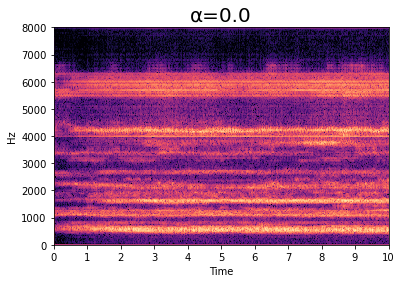

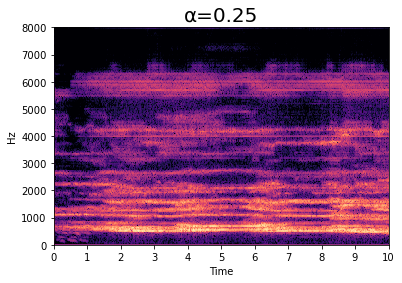

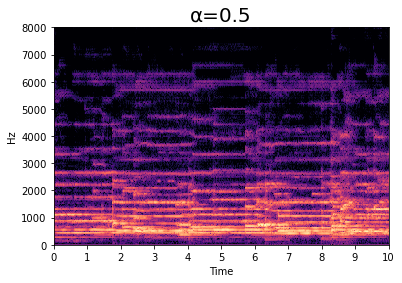

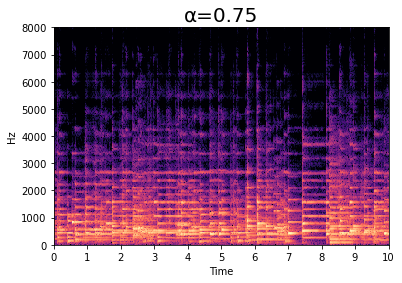

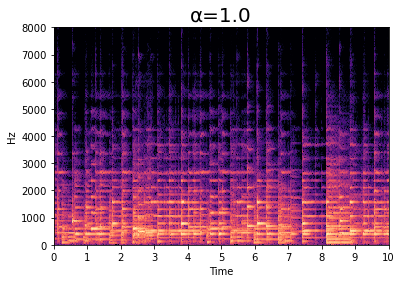

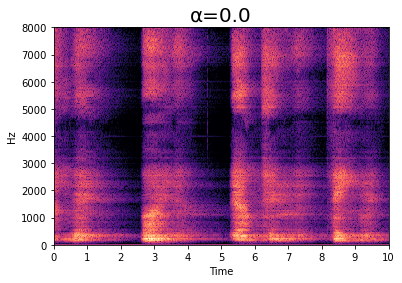

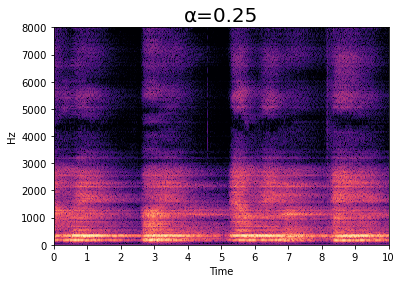

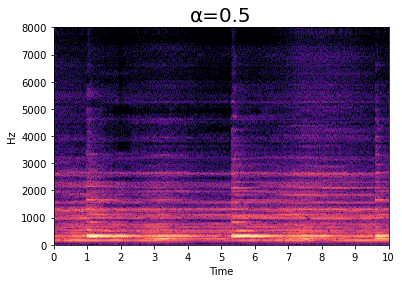

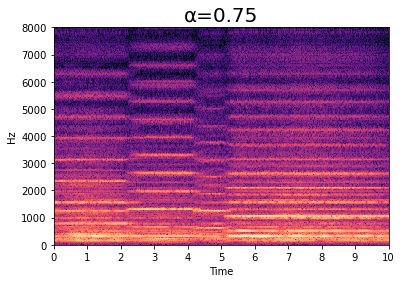

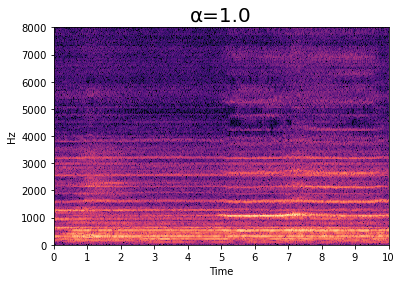

In [58]:
images_dir = 'resources/webpage_samples_images/morphing/adjective_morphing'
aud_dir = 'resources/webpage_samples/morphing/adjective_morphing'

listoffiles = os.listdir(aud_dir)
uniquef = []
for f in listoffiles:
    uniquef.append('_'.join(f.split('_')[:-1]))

uniquef = set(uniquef)
print(uniquef)

os.makedirs(images_dir, exist_ok=True)
for f in uniquef:
    for i in range(5):
        fname = f+'_'+str(i)+'.wav'
        print(fname)
        audio, sr = librosa.load(aud_dir +'/'+fname, sr=16000)

#         print(sr)
        plt.figure()
        D = librosa.amplitude_to_db(np.abs(librosa.stft(audio, n_fft=512, hop_length=128)), ref=np.max)
        img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, hop_length=128)

        plt.xlim((0,10))
        alpha=str(i/4).format('{0:.2f}')
        plt.title('⍺='+alpha, fontsize=20)
        plt.savefig(os.path.join(images_dir,f+'_'+str(i)+'.png'))


{'A_dog_barking_to_A_cat_meowing', 'A_baby_sadly_crying_to_A_trumpet_happily_playing', 'A_trumpet_playing_to_A_clarinet_playing', 'A_man_speaking_to_A_croaking_frog', 'A_dog_howling_to_A_gong_ringing'}
A_dog_barking_to_A_cat_meowing_0.wav
A_dog_barking_to_A_cat_meowing_1.wav
A_dog_barking_to_A_cat_meowing_2.wav
A_dog_barking_to_A_cat_meowing_3.wav
A_dog_barking_to_A_cat_meowing_4.wav
A_baby_sadly_crying_to_A_trumpet_happily_playing_0.wav
A_baby_sadly_crying_to_A_trumpet_happily_playing_1.wav
A_baby_sadly_crying_to_A_trumpet_happily_playing_2.wav
A_baby_sadly_crying_to_A_trumpet_happily_playing_3.wav
A_baby_sadly_crying_to_A_trumpet_happily_playing_4.wav
A_trumpet_playing_to_A_clarinet_playing_0.wav
A_trumpet_playing_to_A_clarinet_playing_1.wav
A_trumpet_playing_to_A_clarinet_playing_2.wav
A_trumpet_playing_to_A_clarinet_playing_3.wav
A_trumpet_playing_to_A_clarinet_playing_4.wav
A_man_speaking_to_A_croaking_frog_0.wav
A_man_speaking_to_A_croaking_frog_1.wav
A_man_speaking_to_A_croaking

<ipython-input-64-f4f0efbf6f25>:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


A_dog_howling_to_A_gong_ringing_1.wav
A_dog_howling_to_A_gong_ringing_2.wav
A_dog_howling_to_A_gong_ringing_3.wav
A_dog_howling_to_A_gong_ringing_4.wav


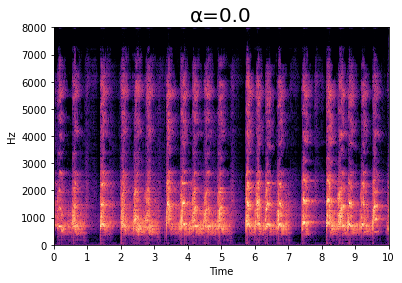

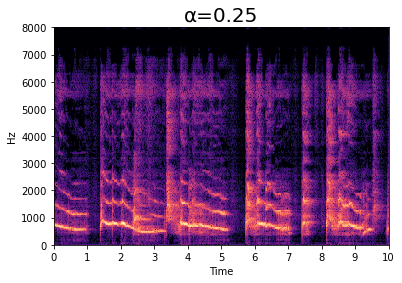

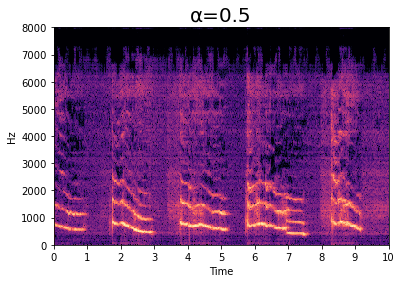

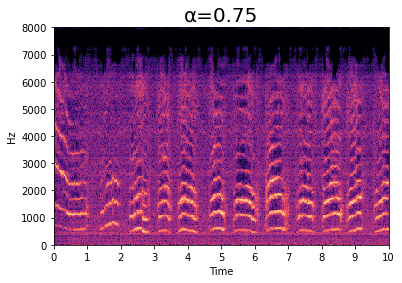

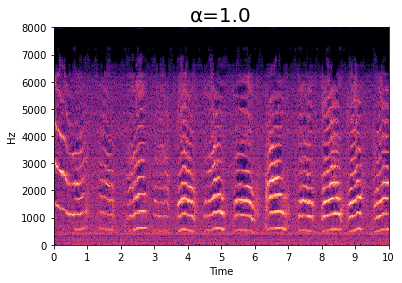

...

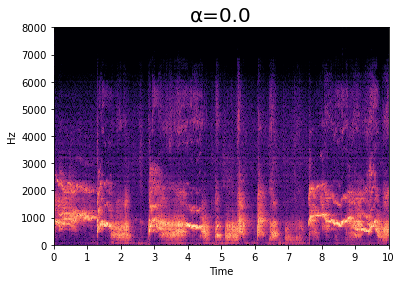

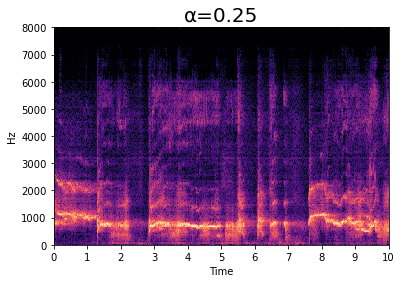

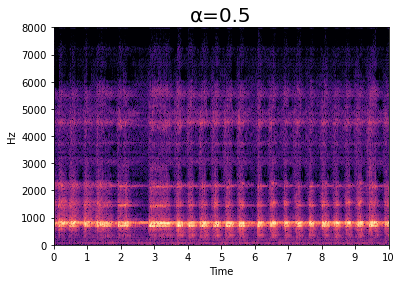

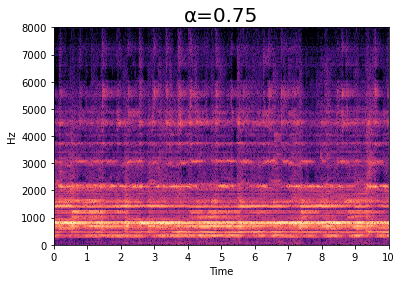

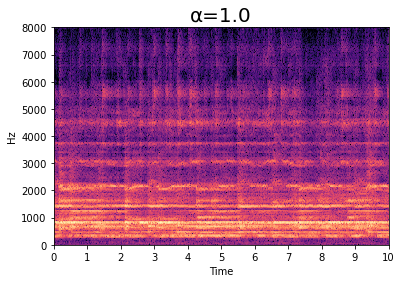

In [64]:
images_dir = 'resources/webpage_samples_images/morphing/verb_morphing'
aud_dir = 'resources/webpage_samples/morphing/verb_morphing'

listoffiles = os.listdir(aud_dir)
uniquef = []
for f in listoffiles:
    uniquef.append('_'.join(f.split('_')[:-1]))

uniquef = set(uniquef)
print(uniquef)

os.makedirs(images_dir, exist_ok=True)
for f in uniquef:
    for i in range(5):
        fname = f+'_'+str(i)+'.wav'
        print(fname)
        audio, sr = librosa.load(aud_dir +'/'+fname, sr=16000)

#         print(sr)
        plt.figure()
        D = librosa.amplitude_to_db(np.abs(librosa.stft(audio, n_fft=512, hop_length=128)), ref=np.max)
        img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, hop_length=128)

        plt.xlim((0,10))
        alpha=str(i/4).format('{0:.2f}')
        plt.title('⍺='+alpha, fontsize=20)
        plt.savefig(os.path.join(images_dir,f+'_'+str(i)+'.png'))


{'A_windy_forest_43', 'A_scary_music_43', 'An_extreme_guitar_43', 'A_frightening_thriller_43', 'Peaceful_waves_1982', 'A_slow_piano_42', 'A_dog_barking_with_reverb_42'}
A_windy_forest_43_-2.wav
A_windy_forest_43_-1.wav
A_windy_forest_43_0.wav
A_windy_forest_43_1.wav
A_windy_forest_43_2.wav
A_windy_forest_43_3.wav
A_scary_music_43_-2.wav
A_scary_music_43_-1.wav
A_scary_music_43_0.wav
A_scary_music_43_1.wav
A_scary_music_43_2.wav
A_scary_music_43_3.wav
An_extreme_guitar_43_-2.wav
An_extreme_guitar_43_-1.wav
An_extreme_guitar_43_0.wav
An_extreme_guitar_43_1.wav
An_extreme_guitar_43_2.wav
An_extreme_guitar_43_3.wav
A_frightening_thriller_43_-2.wav
A_frightening_thriller_43_-1.wav
A_frightening_thriller_43_0.wav


<ipython-input-48-0fcfbf01f3c1>:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


A_frightening_thriller_43_1.wav
A_frightening_thriller_43_2.wav
A_frightening_thriller_43_3.wav
Peaceful_waves_1982_-2.wav
Peaceful_waves_1982_-1.wav
Peaceful_waves_1982_0.wav
Peaceful_waves_1982_1.wav
Peaceful_waves_1982_2.wav
Peaceful_waves_1982_3.wav
A_slow_piano_42_-2.wav
A_slow_piano_42_-1.wav
A_slow_piano_42_0.wav
A_slow_piano_42_1.wav
A_slow_piano_42_2.wav
A_slow_piano_42_3.wav
A_dog_barking_with_reverb_42_-2.wav
A_dog_barking_with_reverb_42_-1.wav
A_dog_barking_with_reverb_42_0.wav
A_dog_barking_with_reverb_42_1.wav
A_dog_barking_with_reverb_42_2.wav
A_dog_barking_with_reverb_42_3.wav


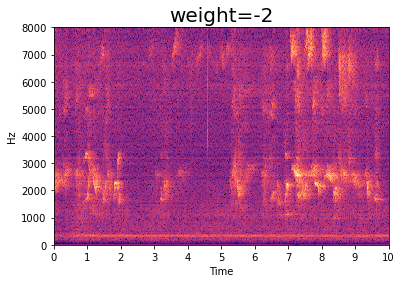

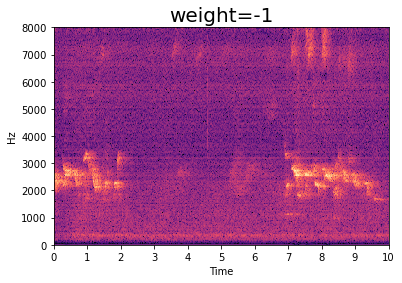

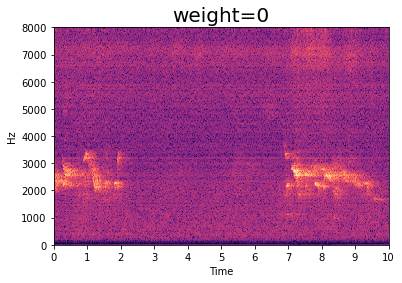

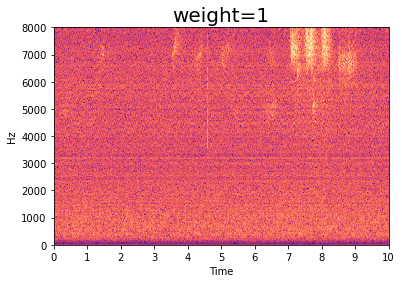

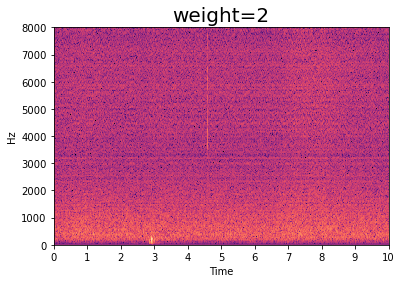

...

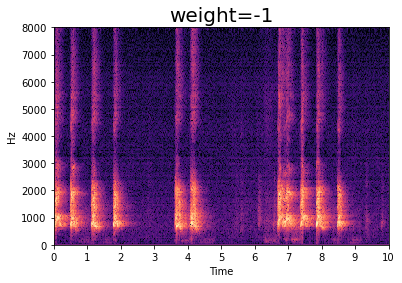

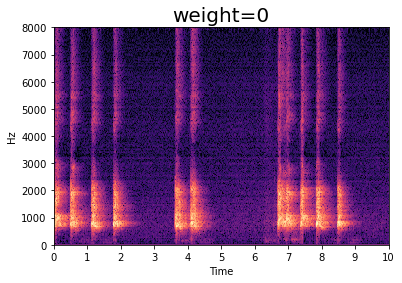

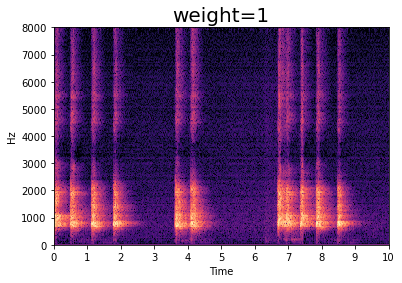

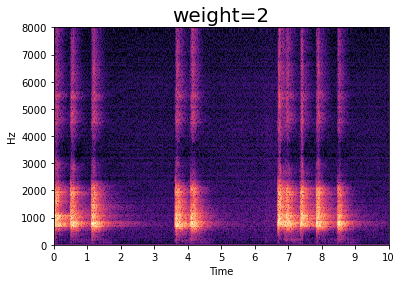

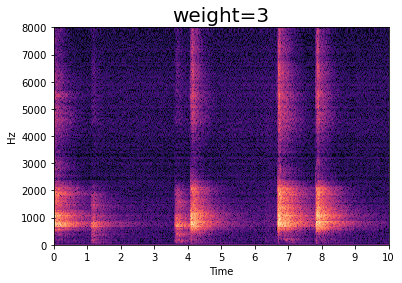

In [48]:
images_dir = 'resources/webpage_samples_images/reweighting/adjective_edits'
aud_dir = 'resources/webpage_samples/reweighting/adjective_edits'

listoffiles = os.listdir(aud_dir)
uniquef = []
for f in listoffiles:
    uniquef.append('_'.join(f.split('_')[:-1]))

uniquef = set(uniquef)
print(uniquef)

os.makedirs(images_dir, exist_ok=True)
for f in uniquef:
    for i in [-2,-1,0,1,2,3]:
        fname = f+'_'+str(i)+'.wav'
        print(fname)
        audio, sr = librosa.load(aud_dir +'/'+fname, sr=16000)

#         print(sr)
        plt.figure()
        D = librosa.amplitude_to_db(np.abs(librosa.stft(audio, n_fft=512, hop_length=128)), ref=np.max)
        img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, hop_length=128)

        plt.xlim((0,10))
        plt.title('weight='+str(i), fontsize=20)
        plt.savefig(os.path.join(images_dir,f+'_'+str(i)+'.png'))


{'A_crying_baby_42', 'A_whispering_voice_43', 'A_ringing_churchbell_42', 'A_laughing_baby_42', 'A_screaming_crowd_42', 'A_singing_woman_1982', 'An_accelerating_engine_42'}
A_crying_baby_42_-2.wav
A_crying_baby_42_-1.wav
A_crying_baby_42_0.wav
A_crying_baby_42_1.wav
A_crying_baby_42_2.wav
A_crying_baby_42_3.wav
A_whispering_voice_43_-2.wav
A_whispering_voice_43_-1.wav
A_whispering_voice_43_0.wav
A_whispering_voice_43_1.wav
A_whispering_voice_43_2.wav
A_whispering_voice_43_3.wav
A_ringing_churchbell_42_-2.wav
A_ringing_churchbell_42_-1.wav
A_ringing_churchbell_42_0.wav
A_ringing_churchbell_42_1.wav
A_ringing_churchbell_42_2.wav
A_ringing_churchbell_42_3.wav
A_laughing_baby_42_-2.wav
A_laughing_baby_42_-1.wav
A_laughing_baby_42_0.wav


<ipython-input-49-b23c07bac3a4>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


A_laughing_baby_42_1.wav
A_laughing_baby_42_2.wav
A_laughing_baby_42_3.wav
A_screaming_crowd_42_-2.wav
A_screaming_crowd_42_-1.wav
A_screaming_crowd_42_0.wav
A_screaming_crowd_42_1.wav
A_screaming_crowd_42_2.wav
A_screaming_crowd_42_3.wav
A_singing_woman_1982_-2.wav
A_singing_woman_1982_-1.wav
A_singing_woman_1982_0.wav
A_singing_woman_1982_1.wav
A_singing_woman_1982_2.wav
A_singing_woman_1982_3.wav
An_accelerating_engine_42_-2.wav
An_accelerating_engine_42_-1.wav
An_accelerating_engine_42_0.wav
An_accelerating_engine_42_1.wav
An_accelerating_engine_42_2.wav
An_accelerating_engine_42_3.wav


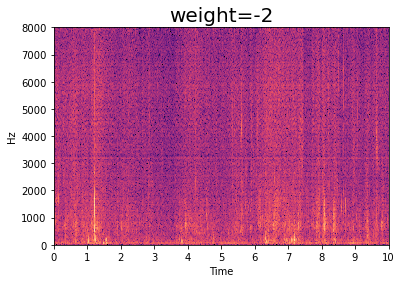

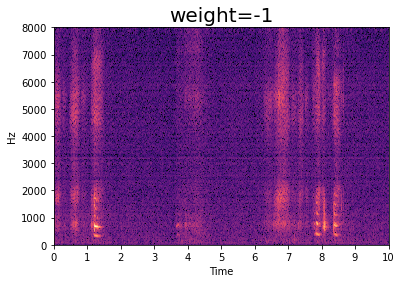

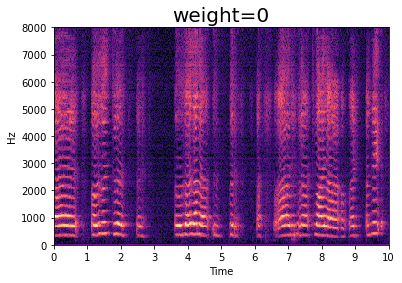

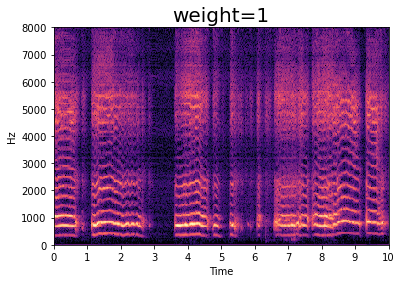

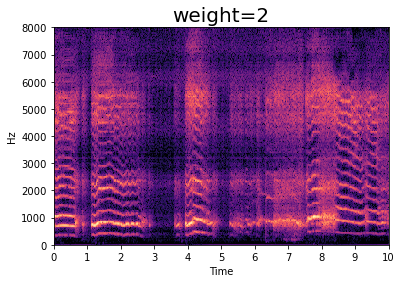

...

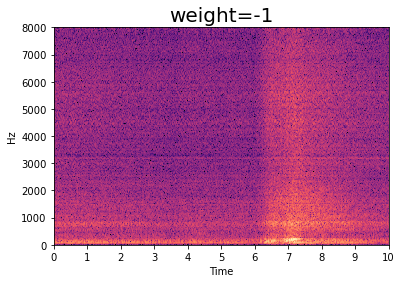

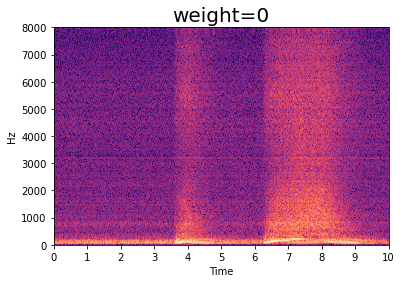

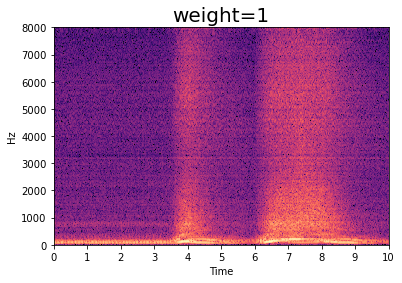

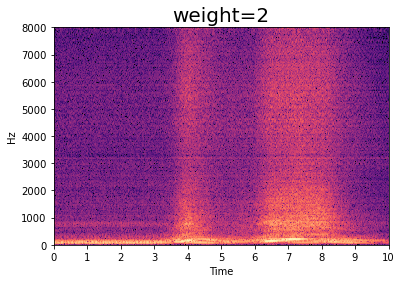

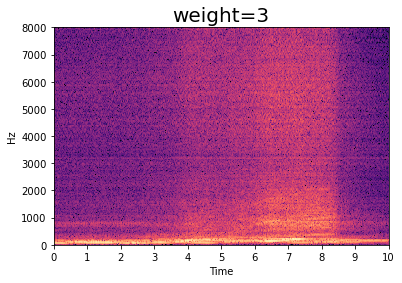

In [49]:
images_dir = 'resources/webpage_samples_images/reweighting/verb_edits'
aud_dir = 'resources/webpage_samples/reweighting/verb_edits'

listoffiles = os.listdir(aud_dir)
uniquef = []
for f in listoffiles:
    if '.ipynb' not in f and '.DS' not in f:
        uniquef.append('_'.join(f.split('_')[:-1]))

uniquef = set(uniquef)
print(uniquef)

os.makedirs(images_dir, exist_ok=True)
for f in uniquef:
    for i in [-2,-1,0,1,2,3]:
        fname = f+'_'+str(i)+'.wav'
        print(fname)
        audio, sr = librosa.load(aud_dir +'/'+fname, sr=16000)

#         print(sr)
        plt.figure()
        D = librosa.amplitude_to_db(np.abs(librosa.stft(audio, n_fft=512, hop_length=128)), ref=np.max)
        img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, hop_length=128)

        plt.xlim((0,10))
        plt.title('weight='+str(i), fontsize=20)
        plt.savefig(os.path.join(images_dir,f+'_'+str(i)+'.png'))


# Listening Test Samples

{'A_funny_effect_to_A_dramatic_suspense', 'A_creepy_terror_to_A_calm_piano', 'A_rattling_glass_to_An_epic_music', 'A_creepy_whisper_to_An_epic_music'}
A_funny_effect_to_A_dramatic_suspense_0.wav
A_funny_effect_to_A_dramatic_suspense_1.wav
A_funny_effect_to_A_dramatic_suspense_2.wav
A_creepy_terror_to_A_calm_piano_0.wav
A_creepy_terror_to_A_calm_piano_1.wav
A_creepy_terror_to_A_calm_piano_2.wav
A_rattling_glass_to_An_epic_music_0.wav
A_rattling_glass_to_An_epic_music_1.wav
A_rattling_glass_to_An_epic_music_2.wav
A_creepy_whisper_to_An_epic_music_0.wav
A_creepy_whisper_to_An_epic_music_1.wav
A_creepy_whisper_to_An_epic_music_2.wav


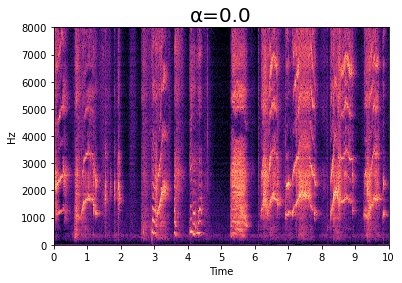

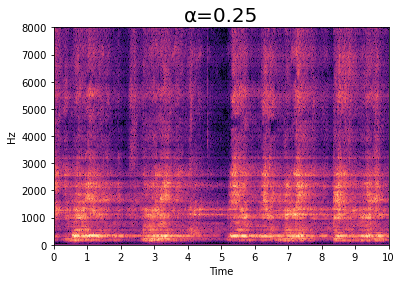

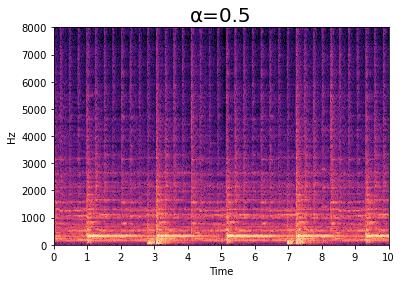

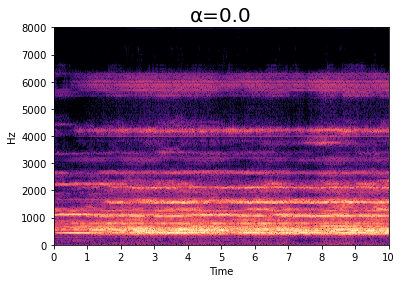

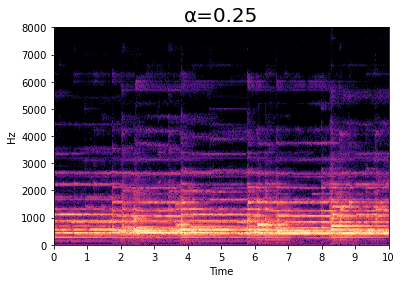

...

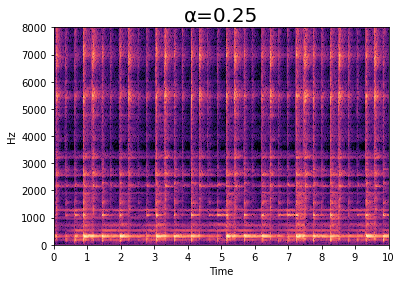

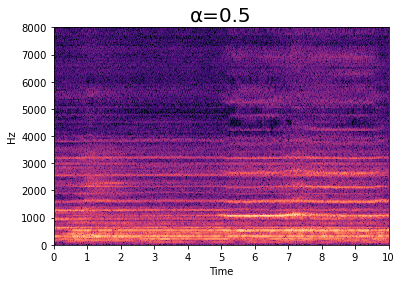

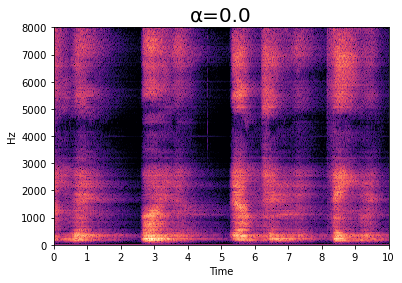

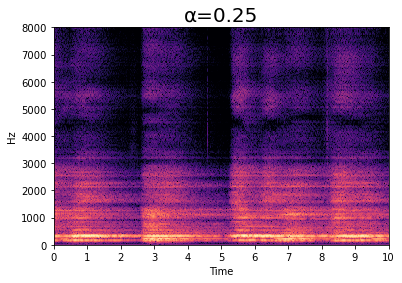

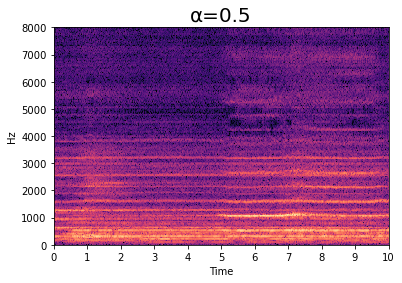

In [60]:
images_dir = 'resources/listening_test_samples_images/morphing/adjective_morphing'
aud_dir = 'resources/listening_test_samples/morphing/adjective_morphing'

listoffiles = os.listdir(aud_dir)
uniquef = []
for f in listoffiles:
    if '.ipynb' not in f:
        uniquef.append('_'.join(f.split('_')[:-1]))

uniquef = set(uniquef)
print(uniquef)

os.makedirs(images_dir, exist_ok=True)
for f in uniquef:
    for i in range(3):
        fname = f+'_'+str(i)+'.wav'
        print(fname)
        audio, sr = librosa.load(aud_dir +'/'+fname, sr=16000)

#         print(sr)
        plt.figure()
        D = librosa.amplitude_to_db(np.abs(librosa.stft(audio, n_fft=512, hop_length=128)), ref=np.max)
        img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, hop_length=128)

        plt.xlim((0,10))
        alpha=str(i/4).format('{0:.2f}')
        plt.title('⍺='+alpha, fontsize=20)
        plt.savefig(os.path.join(images_dir,f+'_'+str(i)+'.png'))


{'A_crackling_footstep_to_A_breaking_wood', 'A_dog_barking_to_A_gong_ringing', 'A_howling_wolf_to_A_crying_baby', 'The_sound_of_a_cow_mooing_to_The_sound_of_a_cat_meowing'}
A_crackling_footstep_to_A_breaking_wood_0.wav
A_crackling_footstep_to_A_breaking_wood_1.wav
A_crackling_footstep_to_A_breaking_wood_2.wav
A_dog_barking_to_A_gong_ringing_0.wav
A_dog_barking_to_A_gong_ringing_1.wav
A_dog_barking_to_A_gong_ringing_2.wav
A_howling_wolf_to_A_crying_baby_0.wav
A_howling_wolf_to_A_crying_baby_1.wav
A_howling_wolf_to_A_crying_baby_2.wav
The_sound_of_a_cow_mooing_to_The_sound_of_a_cat_meowing_0.wav
The_sound_of_a_cow_mooing_to_The_sound_of_a_cat_meowing_1.wav
The_sound_of_a_cow_mooing_to_The_sound_of_a_cat_meowing_2.wav


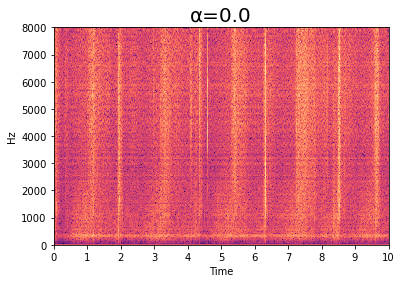

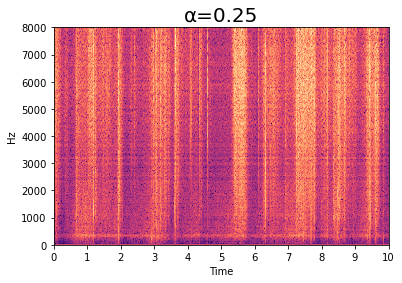

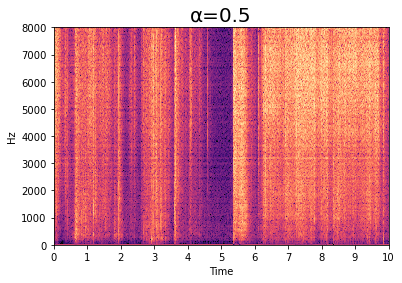

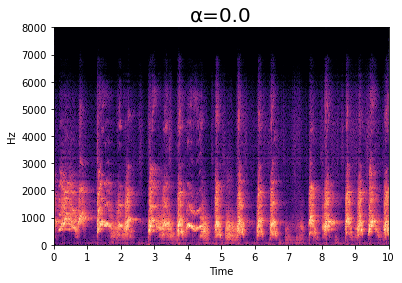

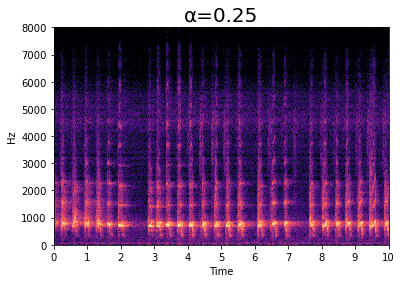

...

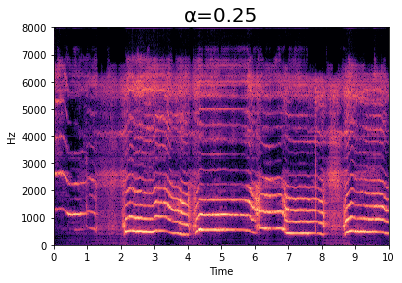

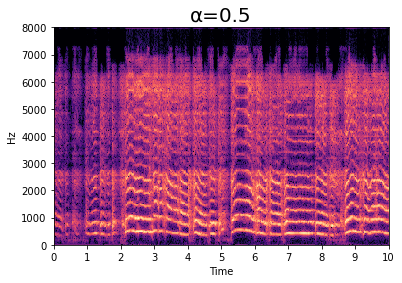

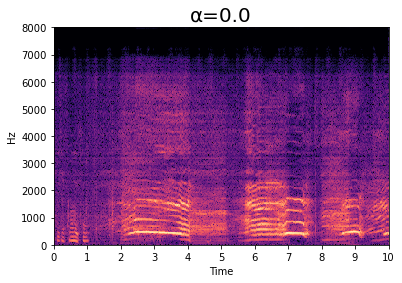

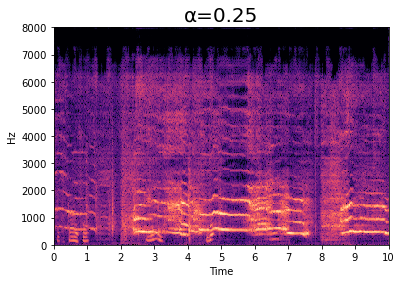

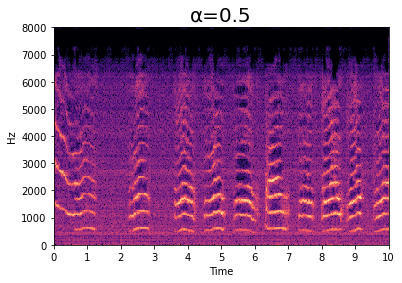

In [61]:
images_dir = 'resources/listening_test_samples_images/morphing/verb_morphing'
aud_dir = 'resources/listening_test_samples/morphing/verb_morphing'

listoffiles = os.listdir(aud_dir)
uniquef = []
for f in listoffiles:
    if '.ipynb' not in f:
        uniquef.append('_'.join(f.split('_')[:-1]))

uniquef = set(uniquef)
print(uniquef)

os.makedirs(images_dir, exist_ok=True)
for f in uniquef:
    for i in range(3):
        fname = f+'_'+str(i)+'.wav'
        print(fname)
        audio, sr = librosa.load(aud_dir +'/'+fname, sr=16000)

#         print(sr)
        plt.figure()
        D = librosa.amplitude_to_db(np.abs(librosa.stft(audio, n_fft=512, hop_length=128)), ref=np.max)
        img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, hop_length=128)

        plt.xlim((0,10))
        alpha=str(i/4).format('{0:.2f}')
        plt.title('⍺='+alpha, fontsize=20)
        plt.savefig(os.path.join(images_dir,f+'_'+str(i)+'.png'))


{'A_slow_piano', 'A_windy_forest', 'A_sad_guitar', 'A_frightening_thriller', 'A_peaceful_waves'}
A_slow_piano_0.wav
A_slow_piano_1.wav
A_slow_piano_2.wav
A_windy_forest_0.wav
A_windy_forest_1.wav
A_windy_forest_2.wav
A_sad_guitar_0.wav
A_sad_guitar_1.wav
A_sad_guitar_2.wav
A_frightening_thriller_0.wav
A_frightening_thriller_1.wav
A_frightening_thriller_2.wav
A_peaceful_waves_0.wav
A_peaceful_waves_1.wav
A_peaceful_waves_2.wav


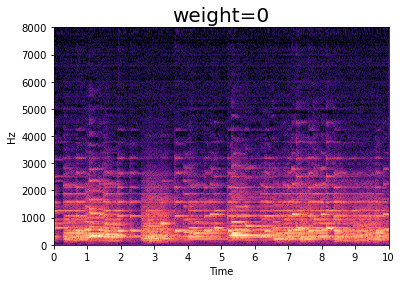

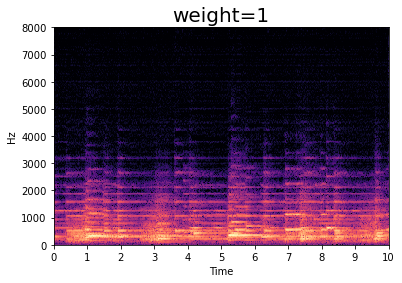

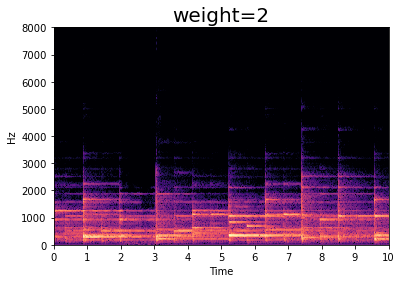

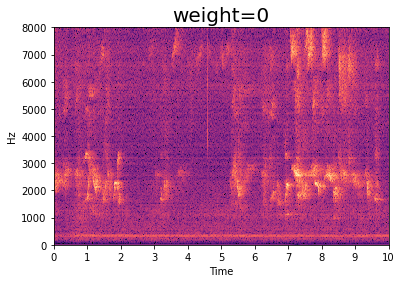

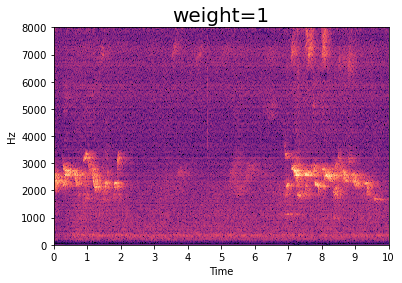

...

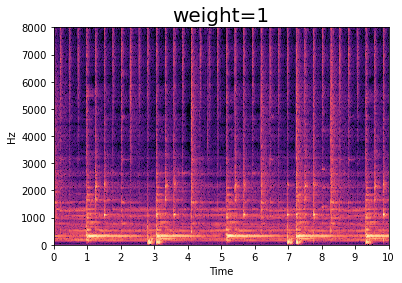

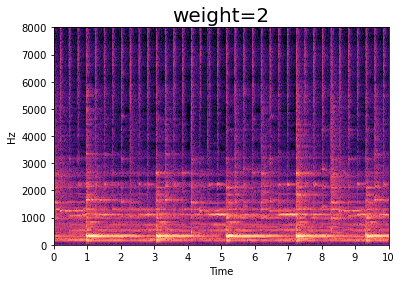

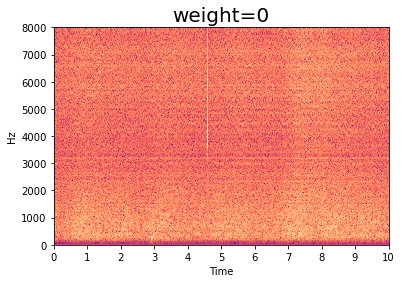

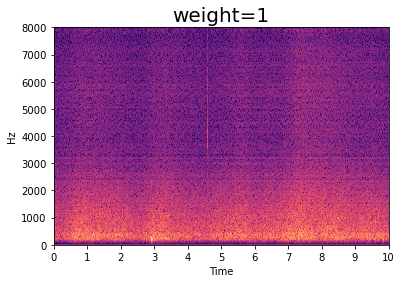

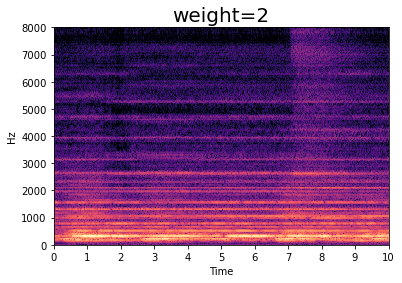

In [52]:
images_dir = 'resources/listening_test_samples_images/reweighting/adjective_edits'
aud_dir = 'resources/listening_test_samples/reweighting/adjective_edits'

listoffiles = os.listdir(aud_dir)
uniquef = []
for f in listoffiles:
    if '.ipynb' not in f and '.DS' not in f:
        uniquef.append('_'.join(f.split('_')[:-1]))

uniquef = set(uniquef)
print(uniquef)

os.makedirs(images_dir, exist_ok=True)
for f in uniquef:
    for i in range(3):
        fname = f+'_'+str(i)+'.wav'
        print(fname)
        audio, sr = librosa.load(aud_dir +'/'+fname, sr=16000)

#         print(sr)
        plt.figure()
        D = librosa.amplitude_to_db(np.abs(librosa.stft(audio, n_fft=512, hop_length=128)), ref=np.max)
        img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, hop_length=128)

        plt.xlim((0,10))
        plt.title('weight='+str(i), fontsize=20)
        plt.savefig(os.path.join(images_dir,f+'_'+str(i)+'.png'))


{'A_crackling_fire', 'A_squeaking_chair', 'A_growling_dragon', 'A_dripping_water', 'A_crying_baby'}
A_crackling_fire_0.wav
A_crackling_fire_1.wav
A_crackling_fire_2.wav
A_squeaking_chair_0.wav
A_squeaking_chair_1.wav
A_squeaking_chair_2.wav
A_growling_dragon_0.wav
A_growling_dragon_1.wav
A_growling_dragon_2.wav
A_dripping_water_0.wav
A_dripping_water_1.wav
A_dripping_water_2.wav
A_crying_baby_0.wav
A_crying_baby_1.wav
A_crying_baby_2.wav


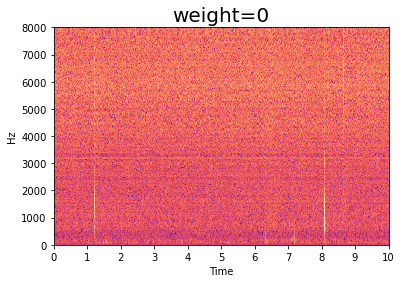

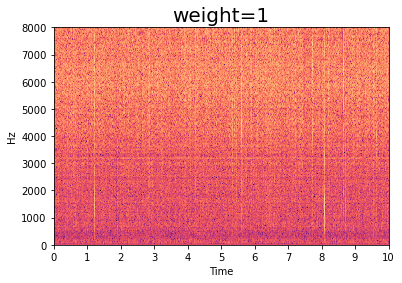

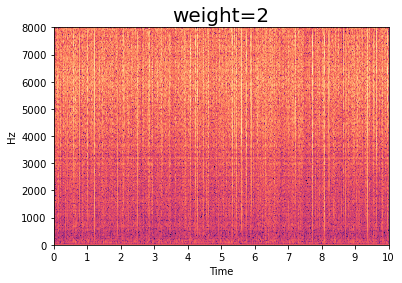

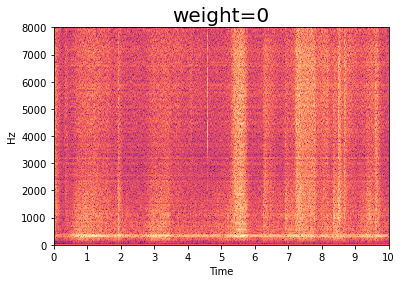

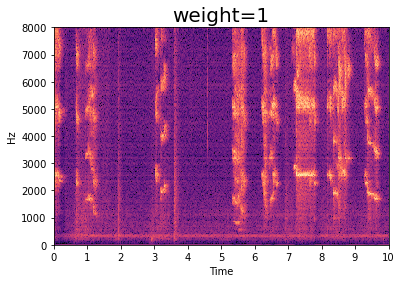

...

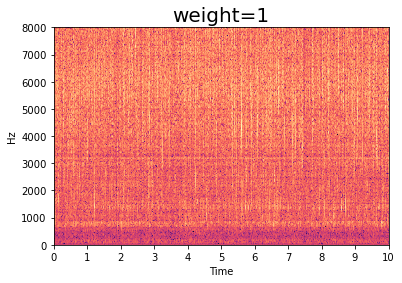

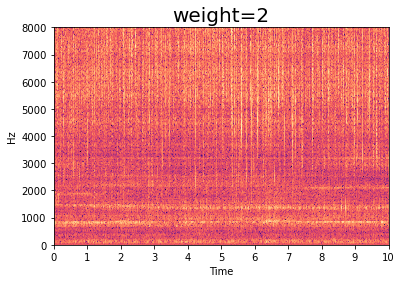

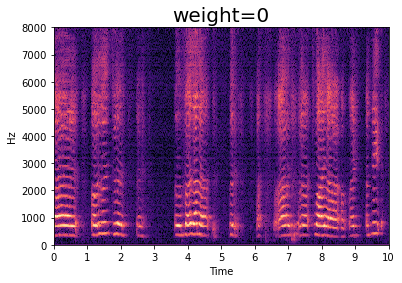

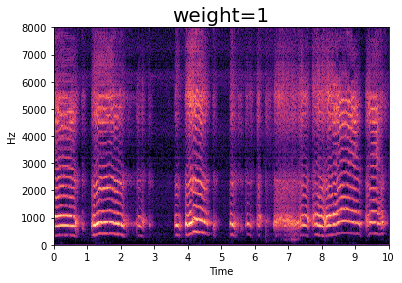

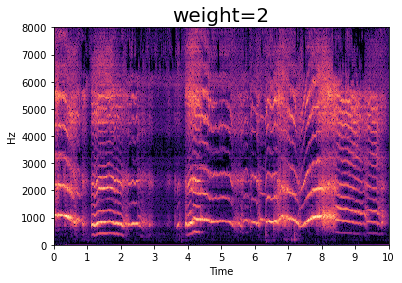

In [53]:
images_dir = 'resources/listening_test_samples_images/reweighting/verb_edits'
aud_dir = 'resources/listening_test_samples/reweighting/verb_edits'

listoffiles = os.listdir(aud_dir)
uniquef = []
for f in listoffiles:
    if '.ipynb' not in f and '.DS' not in f:
        uniquef.append('_'.join(f.split('_')[:-1]))

uniquef = set(uniquef)
print(uniquef)

os.makedirs(images_dir, exist_ok=True)
for f in uniquef:
    for i in range(3):
        fname = f+'_'+str(i)+'.wav'
        print(fname)
        audio, sr = librosa.load(aud_dir +'/'+fname, sr=16000)

#         print(sr)
        plt.figure()
        D = librosa.amplitude_to_db(np.abs(librosa.stft(audio, n_fft=512, hop_length=128)), ref=np.max)
        img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, hop_length=128)

        plt.xlim((0,10))
        plt.title('weight='+str(i), fontsize=20)
        plt.savefig(os.path.join(images_dir,f+'_'+str(i)+'.png'))
